#Project #1 2D EKF based SLAM

### Authors
* Bruno Silva 201906367
* João Castro 201904859

<br>
<br>

The ultimate goal of this project is the implementation and testing of a simultaneous localization and
mapping (SLAM) system for a robot equipped with a laser that measures distance and bearing to land-
marks located in the operation area.
The position of the robot on the plane is defined by the coordinates (x, y) and its orientation is defined
by θ. The robot is able to measure its linear and angular velocities, respectively v and ω and consider
the motion can be modeled by
* $\dot x$ = v cos θ
* $\dot y$ = v sin θ
* $\dot \theta$ = ω

v and ω measurements are affeted by noises which are characterized by independent normal distributions
with zero mean and variences σ2
v = 0.52 and σ2
ω = 0.052.
The robot has a laser systems that is able to measure its distance (r) and bearing (ψ, in the robot
own reference frame) to landamarks located in the operation area. These meaurements are affected by
noises characterized by independent normal distributions with zero mean and variances σ2
r = 0.52 and
σ2
ψ = 0.12.

In [ ]:
# Get the data from the DropBox link in a .zip
!wget -O data_pm.zip https://www.dropbox.com/scl/fi/gp49ewzvvk9jrxnkh94yu/data_pm.zip?rlkey=lz596ym0az9mtaopqydqvf1o4&dl=0

# Unzip the data to the directory Datasets-20231026
!unzip -q data_pm.zip -d 'Datasets-20231026'

--2023-11-10 23:54:46--  https://www.dropbox.com/scl/fi/gp49ewzvvk9jrxnkh94yu/data_pm.zip?rlkey=lz596ym0az9mtaopqydqvf1o4
Resolving www.dropbox.com (www.dropbox.com)... 162.125.65.18, 2620:100:6021:18::a27d:4112
Connecting to www.dropbox.com (www.dropbox.com)|162.125.65.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://uc4e3beaf8eafbcd8f0a43051416.dl.dropboxusercontent.com/cd/0/inline/CHTX6ag_uHf6dYLb2ydebT7RjuW1TEp12IVFSBcbeITNyszifCickaeF3W6haah0zfUibb9_od7_8rJ_I1GxNryZqxPudRfWzWgNPOlLF_xwVrnGXsZtFSQzA02h_E8Flw7O56D0vN7Ukrqod4GdijgX/file# [following]
--2023-11-10 23:54:47--  https://uc4e3beaf8eafbcd8f0a43051416.dl.dropboxusercontent.com/cd/0/inline/CHTX6ag_uHf6dYLb2ydebT7RjuW1TEp12IVFSBcbeITNyszifCickaeF3W6haah0zfUibb9_od7_8rJ_I1GxNryZqxPudRfWzWgNPOlLF_xwVrnGXsZtFSQzA02h_E8Flw7O56D0vN7Ukrqod4GdijgX/file
Resolving uc4e3beaf8eafbcd8f0a43051416.dl.dropboxusercontent.com (uc4e3beaf8eafbcd8f0a43051416.dl.dropboxusercontent.com)... 162.125.13.15, 262

##Task 1
Consider that there are two landmaks located at (0, 0 and (10, 0), and that the initial pose of the robot
is known. Design and implement an algorihtm to estimate the position and orientation of the robot
based on the measurements of linear and angular velocities and also on the distances and bearings to
the two beacons. Use the data in file data1.txt to test the algorithm. The columns of this file are
t, x, y, θ, v, ω, r1, ψ1, r2, ψ2.

Since the animations in each task take over 3 minutos to load, a flag was created for each task, which enables or disables the animation. If one does not want to wait for the animation while running the cell, the variable *ani_enable1* must be set to 0.

In [ ]:
ani_enable1 = 0

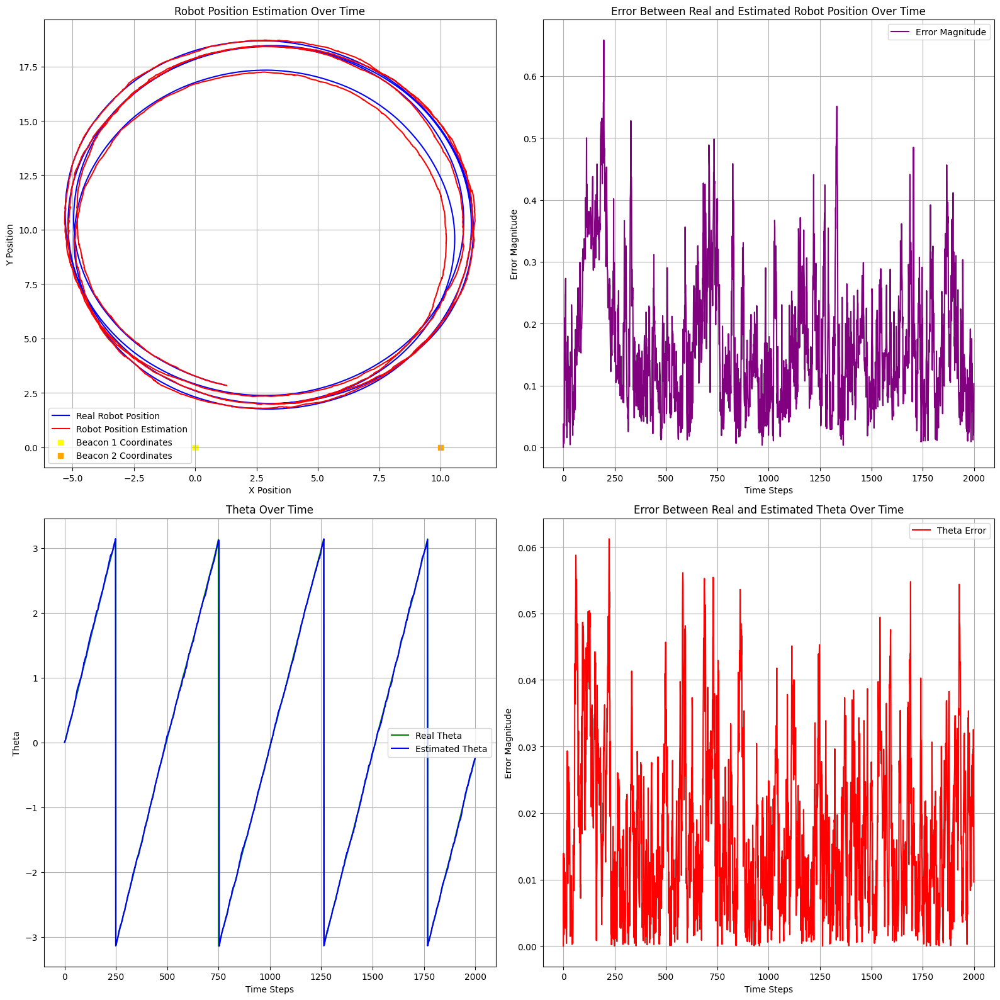

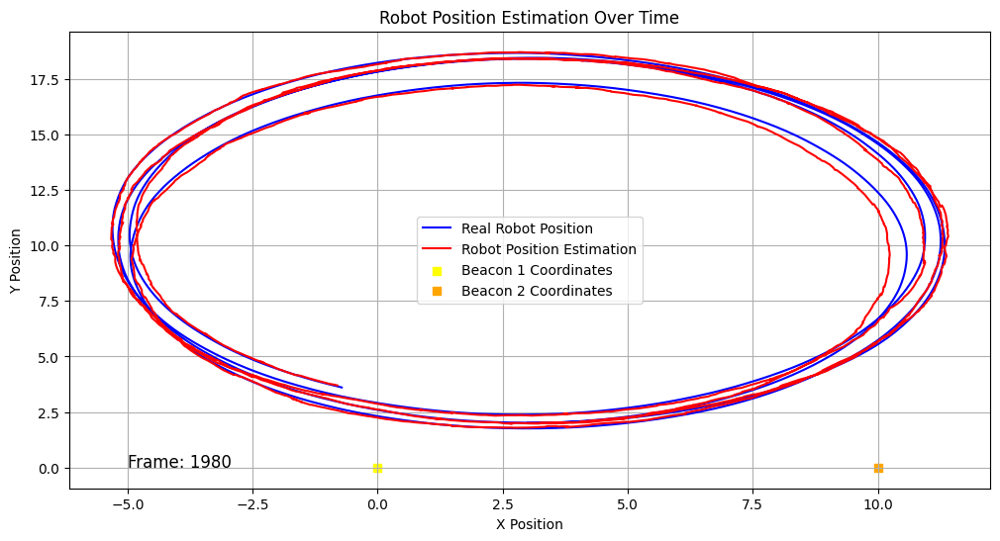

In [ ]:
import numpy as np
from numpy import *
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Set the embed_limit rc parameter to a larger value
#plt.rcParams['animation.embed_limit'] = 50 * 1024 * 1024

def ang_normalized(ang):

    ang_normalized = ang

    while ang_normalized > np.pi:
        ang_normalized = ang_normalized - 2*np.pi

    while ang_normalized <= -np.pi:
        ang_normalized = ang_normalized + 2*np.pi

    return ang_normalized

# Iteration number
N = 2000

# Lists for the results
X_t = []
X_e_t = []

# Initialize an empty list to store the data
data_list = []

# Open the data file for reading
with open('/content/Datasets-20231026/data1.txt', 'r') as file:
    for line in file:
        # Split the line into individual values using spaces as the delimiter
        values = line.split()

        # Convert the values to the appropriate data types (float in this case)
        t = float(values[0])
        x = float(values[1])
        y = float(values[2])
        theta = float(values[3])
        v = float(values[4])
        omega = float(values[5])
        r1 = float(values[6])
        psi1 = float(values[7])
        r2 = float(values[8])
        psi2 = float(values[9])

        # Create a dictionary for the current line and append it to the data list
        row_data = {
            't': t,
            'x': x,
            'y': y,
            'theta': theta,
            'v': v,
            'omega': omega,
            'r1': r1,
            'psi1': psi1,
            'r2': r2,
            'psi2': psi2
        }
        data_list.append(row_data)

# Get the data in the respective lists
time = [row['t'] for row in data_list]
x = [row['x'] for row in data_list]
y = [row['y'] for row in data_list]
theta = [row['theta'] for row in data_list]
v = [row['v'] for row in data_list]
w = [row['omega'] for row in data_list]
r1 = [row['r1'] for row in data_list]
psi1 = [row['psi1'] for row in data_list]
r2 = [row['r2'] for row in data_list]
psi2 = [row['psi2'] for row in data_list]


# Covariances
P = np.eye(3)*1e-3
Q = np.array([[0.5**2, 0],
     [0, 0.05**2 ]])

# Std for the beacons
sdv_r = 0.5
sdv_psi = 0.1

R = np.array([[sdv_r ** 2, 0],
              [0, sdv_psi ** 2]])

# Variables to record simulation
X_t = []
X_e_t = []

# Beacons coordinates
xp1 = 0
yp1 = 0
xp2 = 10
yp2 = 0

# initial value for the estimated state
X_e = [[x[0]], [y[0]], [theta[0]]]
X = [[x[0]], [y[0]], [theta[0]]]
X_t.append(X)
X_e_t.append(X_e)
xr_e = x[0]
yr_e = y[0]
theta_r_e = theta[0]



# Sampling period
dt = 0.1

for i in range(N-1):

    # Real Trajectory
    X = [[x[i]], [y[i]], [theta[i]]]

    xr_e = X_e_t[i][0][0]
    yr_e = X_e_t[i][1][0]
    theta_r_e = X_e_t[i][2][0]
    # Predict X(k+1) = f(X(k),U)
    x_k = xr_e + v[i]/w[i] * (np.sin(theta_r_e + w[i]*dt) - np.sin(theta_r_e))
    y_k = yr_e + v[i]/w[i] * (np.cos(theta_r_e) - np.cos(theta_r_e + w[i]*dt))
    theta_k = theta_r_e + w[i] * dt
    X_e = np.array([[x_k], [y_k], [theta_k]])


    # Gradient of f(X)
    grad_f_X = np.array([[1, 0, v[i]/w[i] * (np.cos(theta_r_e + w[i]*dt) - np.cos(theta_r_e))],
            [0, 1, v[i]/w[i] * (np.sin(theta_r_e + w[i]*dt) - np.sin(theta_r_e))],
            [0, 0, 1]])

    # Gradient of f(U)
    grad_f_U = np.array([[1/w[i] * (np.sin(theta_r_e + w[i]*dt) - np.sin(theta_r_e)), v[i]/(w[i]**2) * (dt*w[i]*np.cos(theta_r_e + w[i]*dt) - np.sin(theta_r_e + w[i]*dt)+ np.sin(theta_r_e))],
            [1/w[i] * (-np.cos(theta_r_e + w[i]*dt) + np.cos(theta_r_e)), v[i]/(w[i]**2) * (dt*w[i]*np.sin(theta_r_e + w[i]*dt) + np.cos(theta_r_e + w[i]*dt) - np.cos(theta_r_e))],
            [0, dt]])

    # Covariance propagation
    P = grad_f_X @ P @ grad_f_X.T + grad_f_U @ Q @ grad_f_U.T

    # Each iteration update using both landmarks
    for j in range(2):

        # Use landamark 1
        if j == 0:
            r, psi, landmark_x, landmark_y = r1[i], psi1[i], xp1, yp1
        # Use landamark 2
        else:
            r, psi, landmark_x, landmark_y = r2[i], psi2[i], xp2, yp2

        # Calculate the distance r
        landmark_distance = np.sqrt((landmark_x - X_e[0][0]) ** 2 + (landmark_y - X_e[1][0]) ** 2)

        z_e = np.array([[landmark_distance],
                    [ang_normalized(np.arctan2((landmark_y - X_e[1][0]), (landmark_x - X_e[0][0])) - X_e[2][0])]])

        fH = np.array([[- (landmark_x - X_e[0][0]) / landmark_distance, - (landmark_y - X_e[1][0]) / landmark_distance, 0],
                    [(landmark_y - X_e[1][0]) / (landmark_distance ** 2), - (landmark_x - X_e[0][0]) / (landmark_distance ** 2), -1]])

        K = P @ fH.T @ np.linalg.inv(fH @ P @ fH.T + R)

        z = np.array([[r],
                    [psi]])

        z_dif = z - z_e
        z_dif[1] = ang_normalized(z_dif[1])
        X_e = X_e + K @ (z_dif)
        X_e[2] = ang_normalized(X_e[2])

        P = P - K @ (fH @ P @ fH.T + R) @ K.T
        # Save the results in lists
    X_t.append(X)
    X_e_t.append(X_e)


# Initialize empty lists for x and y values
x_real = []
y_real = []
x_est = []
y_est = []
theta_est = []
theta_real = []

# Extract x and y values from each array in the list
for array in X_t:
    x_real.append(array[0])  # Extract x (first element)
    y_real.append(array[1])  # Extract y (second element)
    theta_real.append(array[2]) # Extract theta (third element)

# Extract x and y values from each array in the list
for array in X_e_t:
    x_est.append(array[0])  # Extract x (first element)
    y_est.append(array[1])  # Extract y (second element)
    theta_est.append(array[2]) # Extract theta (third element)


# Create a figure with a 4x4 subplot layout
fig, axs = plt.subplots(2, 2, figsize=(16, 16))

# Plot for 'x' vs. 'y'
axs[0, 0].plot(x_real, y_real, label='Real Robot Position', color='b')
axs[0, 0].plot(x_est, y_est, label='Robot Position Estimation', color='r')
axs[0, 0].scatter(xp1, yp1, label='Beacon 1 Coordinates', color='yellow', marker='s')
axs[0, 0].scatter(xp2, yp2, label='Beacon 2 Coordinates', color='orange', marker='s')
axs[0, 0].set_xlabel('X Position')
axs[0, 0].set_ylabel('Y Position')
axs[0, 0].set_title('Robot Position Estimation Over Time')
axs[0, 0].legend()
axs[0, 0].grid(True)

# Calculate error using square root of sum of squared distances
error = np.sqrt((np.array(x_real) - np.array(x_est))**2 + (np.array(y_real) - np.array(y_est))**2)

# Plot for the error
axs[0, 1].plot(error, label='Error Magnitude', color='purple')
axs[0, 1].set_xlabel('Time Steps')
axs[0, 1].set_ylabel('Error Magnitude')
axs[0, 1].set_title('Error Between Real and Estimated Robot Position Over Time')
axs[0, 1].legend()
axs[0, 1].grid(True)

# Plot for 'theta_real' and 'theta_est'
axs[1, 0].plot(theta_real, label='Real Theta', color='green')
axs[1, 0].plot(theta_est, label='Estimated Theta', color='blue')
axs[1, 0].set_xlabel('Time Steps')
axs[1, 0].set_ylabel('Theta')
axs[1, 0].set_title('Theta Over Time')
axs[1, 0].legend()
axs[1, 0].grid(True)

# Calculate error for theta
theta_error = np.abs(np.array(theta_real) - np.array(theta_est))

# Set values greater than 1 to 0
theta_error[theta_error > 1] = 0

# Plot for the theta error
axs[1, 1].plot(theta_error, label='Theta Error', color='red')
axs[1, 1].set_xlabel('Time Steps')
axs[1, 1].set_ylabel('Error Magnitude')
axs[1, 1].set_title('Error Between Real and Estimated Theta Over Time')
axs[1, 1].legend()
axs[1, 1].grid(True)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plots
plt.show()

def update(frame):
    frame = frame * 20
    plt.clf()  # Clear the previous frame
    plt.plot(x_real[:frame], y_real[:frame], label='Real Robot Position', color='b')
    plt.plot(x_est[:frame], y_est[:frame], label='Robot Position Estimation', color='r')
    plt.scatter(xp1, yp1, label='Beacon 1 Coordinates', color='yellow', marker='s')
    plt.scatter(xp2, yp2, label='Beacon 2 Coordinates', color='orange', marker='s')
    plt.xlabel('X Position')
    plt.ylabel('Y Position')
    plt.title('Robot Position Estimation Over Time')
    plt.text(-5, 0, f'Frame: {frame}', fontsize=12, color='black')  # Add frame number as text
    plt.legend()
    plt.grid(True)

if(ani_enable1 == 1):
  # Create a figure
  plt.figure(figsize=(12, 6))

  ani = FuncAnimation(plt.gcf(), update, frames=100, repeat=False)
  display(HTML(ani.to_jshtml()))

  plt.show()





### Considerations for Task 1

Regarding the first task, the main goal was to estimate and predict the position and orientation of the robot based on its intrinsic measurements of linear and angular velocity, as well as the distance and bearing concerning two beacons located at (0, 0) and (10, 0). Along with this information, the motion equations were also provided, as such:

* x = v cos θ
* y = v sin θ
* θ = ω

Initially, it was necessary to define an algorithm that would allow fusing the data that was being received from the measurements (distance and bearing) in addition to the information that would stem from the motion model given the current linear and angular velocities. Given the circumstances, the algorithm adopted was the Kalman Filter.

Knowing that:

\begin{equation}
θ(t) = ω_k \longleftrightarrow θ(t) = θ_k + w_k \cdot(t-t_k)
\end{equation}

Then:
\begin{equation}
 ∫\dot x dt = \int_{t}^{t_k+1} v_k ⋅ cos(θ_k + w_k \cdot (t - t_k)) dt
 \longleftrightarrow x_{k+1} = x_k + \frac{v_k}{w_k} \cdot [sin(θ_{k+1}) - sin(θ_k)]
\end{equation}

Consequently:

\begin{equation}
    \begin{cases}
        x_{k+1} = x_k + \frac{v_k}{w_k} \cdot [sin(θ_{k+1}) - sin(θ_k)]\\
        y_{k+1} = y_k + \frac{v_k}{w_k} \cdot [cos(θ_k)-cos(θ_{k+1}) ]\\
        θ_{k+1} = θ_k + w_k \cdot Δt
    \end{cases}
\end{equation}

<br>

The above equations will be the ones used regarding the odometry of the robot. One major problem that comes from the odometry is the fact that the covariance of the estimated position of the robot will keep increasing according to the covariance of the odometry (Q), leading to a more uncertain position of the robot, as such:

<br>

\begin{equation}
P_{k+1} = F_xPF_x^T + F_uQF_u^T
\end{equation}

<br>

To correct the position of the robot it is necessary to use the second part of the Kalman Filter, the Update Step:

In the update step, the data from the beacons will be incorporated into the algorithm to reduce the covariance of the position estimate, as so:

<br>

 \begin{equation} \hat x_{k+1} = \hat x_{k} + K_{k+1} \cdot (z_{k+1} -  h(\hat x_k))
\end{equation}

<br>

 \begin{equation} K_{k+1} = P_{k}H^{T}(HP_{k}H^{T} + R)^{-1}
\end{equation}

<br>

To correct the position estimate first it is necessary to find the Kalman Gain (K) that, in short, will determine how much trust should be deposited in the measurements according to their covariance matrix (R). The Kalman Gain will increase if the measurement error is small, meaning that the measurements should be trusted and have a higher impact on the calculation of the position estimate, it will decrease if the measurement error is high, meaning that more trust will be deposited in the odometry of the robot.

To correct the position estimate it is necessary to convert our position from (x, y, theta) to the measurement coordinate system (distance and bearing):

<br>

 \begin{equation} Distance = \sqrt{(x_{beacon} - x_r)^2 + (y_{beacon} - y_r)^2}
\end{equation}

<br>

 \begin{equation} Bearing = \arctan(\frac{y_{beacon} - y_r}{x_{beacon} - x_r}) - θ_r
\end{equation}

<br>

To conclude, the main purpose of the fusion of the measurements with the odometry is the fact that the covariance will reduce significantly, as this is the last step of the update section of the Kalman Filter:

<br>

 \begin{equation} P_{k+1} = (I - K_{k+1}H)P_k
\end{equation}

<br>

According to the graphs presented above, since we are continuously receiving measurements from both beacons at all times, both estimated position and orientation have a very small error along the whole trajectory.






















##Task 2

Now assume that laser system has a finite field of view. When each landmark is not within the field of
view (± π
4 ) the range measurement returns 0. Adapt the previous algorithm to take into account this
field of view constraint. Use the data in file data2.txt to test the algorithm. The columns of this file
are t, x, y, θ, v, ω, r1, ψ1, r2, ψ2.

In [ ]:
ani_enable2 = 0

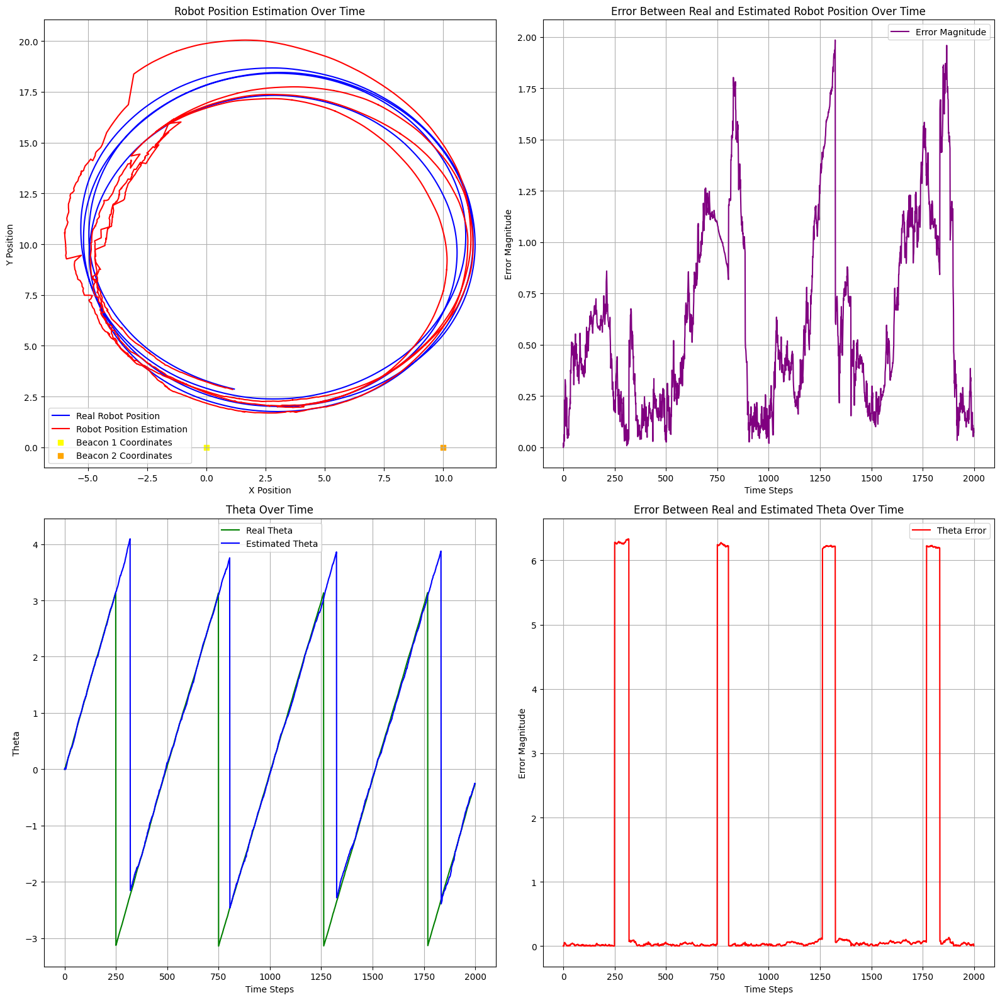

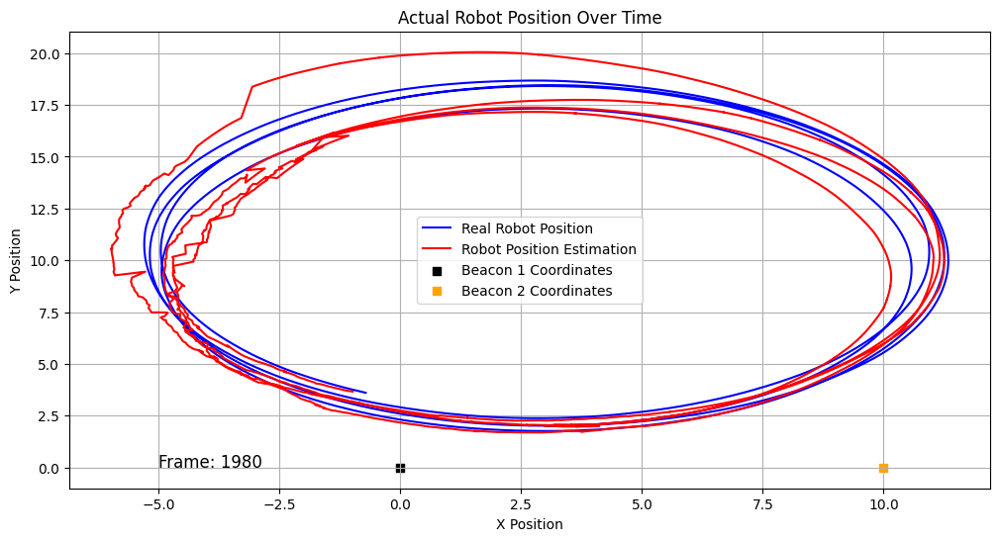

In [ ]:
import numpy as np
from numpy import *
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

def ang_normalized(ang):

    ang_normalized = ang

    while ang_normalized > np.pi:
        ang_normalized = ang_normalized - 2*np.pi

    while ang_normalized <= -np.pi:
        ang_normalized = ang_normalized + 2*np.pi

    return ang_normalized

# Iteration number
N = 2000

# Lists for the results
X_t = []
X_e_t = []
Zmed = []
Zest = []
Ks = []

# Initialize an empty list to store the data
data_list = []

# Open the data file for reading
with open('/content/Datasets-20231026/data2.txt', 'r') as file:
    for line in file:
        # Split the line into individual values using spaces as the delimiter
        values = line.split()

        # Convert the values to the appropriate data types (float in this case)
        t = float(values[0])
        x = float(values[1])
        y = float(values[2])
        theta = float(values[3])
        v = float(values[4])
        omega = float(values[5])
        r1 = float(values[6])
        psi1 = float(values[7])
        r2 = float(values[8])
        psi2 = float(values[9])

        # Create a dictionary for the current line and append it to the data list
        row_data = {
            't': t,
            'x': x,
            'y': y,
            'theta': theta,
            'v': v,
            'omega': omega,
            'r1': r1,
            'psi1': psi1,
            'r2': r2,
            'psi2': psi2
        }
        data_list.append(row_data)

# Get the data in the respective lists
time = [row['t'] for row in data_list]
x = [row['x'] for row in data_list]
y = [row['y'] for row in data_list]
theta = [row['theta'] for row in data_list]
v = [row['v'] for row in data_list]
w = [row['omega'] for row in data_list]
r1 = [row['r1'] for row in data_list]
psi1 = [row['psi1'] for row in data_list]
r2 = [row['r2'] for row in data_list]
psi2 = [row['psi2'] for row in data_list]


# Covariances
P = np.eye(3)*1e-2
Q = np.array([[0.5**2, 0],
     [0, 0.05**2 ]])

# Std for the beacons
sdv_r = 0.5
sdv_psi = 0.1

# Variables to record simulation
X_t = []
X_e_t = []
Zmed = []
Zest = []
Ks = []

# Beacons coordinates
xp1 = 0
yp1 = 0
xp2 = 10
yp2 = 0

# initial value for the estimated state
X_e = [[x[0]], [y[0]], [theta[0]]]
X_e_t.append(X_e)
X = [[x[0]], [y[0]], [theta[0]]]
X_t.append(X)
xr_e = x[0]
yr_e = y[0]
theta_r_e = theta[0]



# Sampling period
dt = 0.1

for i in range(N-1):

    # Real Trajectoryxr_e
    X = [[x[i]], [y[i]], [theta[i]]]

    xr_e = X_e_t[i][0][0]
    yr_e = X_e_t[i][1][0]
    theta_r_e = X_e_t[i][2][0]

    # Predict X(k+1) = f(X(k),U)
    xk= xr_e + v[i]/w[i] * (np.sin(theta_r_e + w[i]*dt) - np.sin(theta_r_e))
    yk = yr_e + v[i]/w[i] * (np.cos(theta_r_e) - np.cos(theta_r_e + w[i]*dt))
    thetak = theta_r_e + w[i] * dt
    X_e = np.array([[xk], [yk], [thetak]])

    # Gradient of f(X)
    grad_f_X = np.array([[1, 0, v[i]/w[i] * (np.cos(thetak + w[i]*dt) - np.cos(thetak))],
            [0, 1, v[i]/w[i] * (np.sin(thetak + w[i]*dt) - np.sin(thetak))],
            [0, 0, 1]])

    # Gradient of f(U)
    grad_f_U = np.array([[1/w[i] * (np.sin(thetak + w[i]*dt) - np.sin(thetak)), v[i]/(w[i]**2) * (dt*w[i]*np.cos(thetak + w[i]*dt) - np.sin(thetak + w[i]*dt)+ np.sin(thetak))],
            [1/w[i] * (-np.cos(thetak + w[i]*dt) + np.cos(thetak)), v[i]/(w[i]**2) * (dt*w[i]*np.sin(thetak + w[i]*dt) + np.cos(thetak + w[i]*dt) - np.cos(thetak))],
            [0, dt]])

    # Covariance propagation
    P = grad_f_X @ P @ grad_f_X.transpose() + grad_f_U @ Q @ grad_f_U.transpose()

    # Check if B1 is in the field of view
    if(r1[i] == 0 and r2[i] != 0):
        # Measures with the actual robot state, z=h(X)
        distp_e_2 = np.sqrt((xp2 - xk)**2 + (yp2- yk)**2)
        psi_p_e_2 = ang_normalized(np.arctan2(yp2 - yk, xp2 - xk) - thetak)

        z_e = np.array([[distp_e_2],
            [psi_p_e_2]])

        z = np.array([[r2[i]],
                [psi2[i]]])

        # Covariance for the measures
        R = [[sdv_r**2, 0],
                [0, sdv_psi**2]]


        # Gradient of h(X)
        grad_h_X  = np.array([[-((xp2 - xk)/(np.sqrt((xp2-xk)**2+(yp2-yk)**2))), -((yp2-yk)/(np.sqrt((xp2-xk)**2+(yp2-yk)**2))), 0],
                [((yp2-yk)/((xp2-xk)**2+(yp2-yk)**2)), -((xp2-xk)/((xp2-xk)**2+(yp2-yk)**2)), -1]])

        # Kalman Gain
        k = P @ grad_h_X.transpose() @ np.linalg.inv(grad_h_X @ P @ grad_h_X.transpose() + R)

        # State update
        z_dif = z - z_e
        z_dif[1] = ang_normalized(z_dif[1])
        X_e = X_e + k @ (z_dif)
        X_e[2] = ang_normalized(X_e[2])

        P = P - k @ (grad_h_X @ P @ grad_h_X.T + R) @ k.T


    # Check if B2 is in the field of view
    elif((r2[i] == 0) and (r1[i] != 0)):
        # Measures with the actual robot state, z=h(X)
        distp_e_1 = np.sqrt((xp1 - xk)**2 + (yp1 - yk)**2)
        psi_p_e_1 = ang_normalized(np.arctan2(yp1 - yk, xp1 - xk) - thetak)

        z_e = np.array([[distp_e_1],
                [psi_p_e_1]])

        z = np.array([[r1[i]],
                [psi1[i]]])

        # Covariance for the measures
        R = [[sdv_r**2, 0],
                [0, sdv_psi**2]]


        # Gradient of h(X)
        grad_h_X  = np.array([[-((xp1 - xk)/(np.sqrt((xp1-xk)**2+(yp1-yk)**2))), -((yp1-yk)/(np.sqrt((xp1-xk)**2+(yp1-yk)**2))), 0],
                [((yp1-yk)/((xp1-xk)**2+(yp1-yk)**2)), -((xp1-xk)/((xp1-xk)**2+(yp1-yk)**2)), -1]])

        # Kalman Gain
        k = P @ grad_h_X.transpose() @ np.linalg.inv(grad_h_X @ P @ grad_h_X.transpose() + R)

        # State update
        z_dif = z - z_e
        z_dif[1] = ang_normalized(z_dif[1])
        X_e = X_e + k @ (z_dif)
        X_e[2] = ang_normalized(X_e[2])

        P = P - k @ (grad_h_X @ P @ grad_h_X.T + R) @ k.T

    # Check if B1 and B2 are in the field of view
    elif(r1[i] != 0 and r2[i] != 0):
        # Measures with the actual robot state, z=h(X)
        distp_e_1 = np.sqrt((xp1 - xk)**2 + (yp1 - yk)**2)
        psi_p_e_1 = ang_normalized(np.arctan2(yp1 - yk, xp1 - xk) - thetak)

        # Measures with the actual robot state, z=h(X)
        distp_e_2 = np.sqrt((xp2 - xk)**2 + (yp2- yk)**2)
        psi_p_e_2 = ang_normalized(np.arctan2(yp2 - yk, xp2 - xk) - thetak)

        z_e = np.array([[distp_e_1],
            [psi_p_e_1],
            [distp_e_2],
            [psi_p_e_2]])

        z = np.array([[r1[i]],
                [psi1[i]],
                [r2[i]],
                [psi2[i]]])

        # Covariance for the measures
        R = [[sdv_r**2, 0, 0, 0],
                [0, sdv_psi**2, 0, 0],
                [0, 0, sdv_r**2, 0],
                [0, 0, 0, sdv_psi**2]]

        # Gradient of h(X)
        grad_h_X  = np.array([[-((xp1 - xk)/(np.sqrt((xp1-xk)**2+(yp1-yk)**2))), -((yp1-yk)/(np.sqrt((xp1-xk)**2+(yp1-yk)**2))), 0],
                [((yp1-yk)/((xp1-xk)**2+(yp1-yk)**2)), -((xp1-xk)/((xp1-xk)**2+(yp1-yk)**2)), -1],
                [-((xp2 - xk)/(np.sqrt((xp2-xk)**2+(yp2-yk)**2))), -((yp2-yk)/(np.sqrt((xp2-xk)**2+(yp2-yk)**2))), 0],
                [((yp2-yk)/((xp2-xk)**2+(yp2-yk)**2)), -((xp2-xk)/((xp2-xk)**2+(yp2-yk)**2)), -1]])

        # Kalman Gain
        k = P @ grad_h_X.transpose() @ np.linalg.inv(grad_h_X @ P @ grad_h_X.transpose() + R)

        # Covariance update
        P = (np.eye(3)- k @ grad_h_X) @ P

        # State update
        z_dif = z - z_e
        z_dif[1] = ang_normalized(z_dif[1])
        z_dif[3] = ang_normalized(z_dif[3])
        X_e = X_e + k @ (z_dif)
        X_e[2] = ang_normalized(X_e[2])

    X_t.append(X)
    X_e_t.append(X_e)




# Initialize empty lists for x and y values
x_real = []
y_real = []
x_est = []
y_est = []
theta_est = []
theta_real = []

# Extract x and y values from each array in the list
for array in X_t:
    x_real.append(array[0])  # Extract x (first element)
    y_real.append(array[1])  # Extract y (second element)
    theta_real.append(array[2]) # Extract theta (third element)

# Extract x and y values from each array in the list
for array in X_e_t:
    x_est.append(array[0])  # Extract x (first element)
    y_est.append(array[1])  # Extract y (second element)
    theta_est.append(array[2]) # Extract theta (third element)

# Create a figure with a 4x4 subplot layout
fig, axs = plt.subplots(2, 2, figsize=(16, 16))

# Plot for 'x' vs. 'y'
axs[0, 0].plot(x_real, y_real, label='Real Robot Position', color='b')
axs[0, 0].plot(x_est, y_est, label='Robot Position Estimation', color='r')
axs[0, 0].scatter(xp1, yp1, label='Beacon 1 Coordinates', color='yellow', marker='s')
axs[0, 0].scatter(xp2, yp2, label='Beacon 2 Coordinates', color='orange', marker='s')
axs[0, 0].set_xlabel('X Position')
axs[0, 0].set_ylabel('Y Position')
axs[0, 0].set_title('Robot Position Estimation Over Time')
axs[0, 0].legend()
axs[0, 0].grid(True)

# Calculate error using square root of sum of squared distances
error = np.sqrt((np.array(x_real) - np.array(x_est))**2 + (np.array(y_real) - np.array(y_est))**2)

# Plot for the error
axs[0, 1].plot(error, label='Error Magnitude', color='purple')
axs[0, 1].set_xlabel('Time Steps')
axs[0, 1].set_ylabel('Error Magnitude')
axs[0, 1].set_title('Error Between Real and Estimated Robot Position Over Time')
axs[0, 1].legend()
axs[0, 1].grid(True)

# Plot for 'theta_real' and 'theta_est'
axs[1, 0].plot(theta_real, label='Real Theta', color='green')
axs[1, 0].plot(theta_est, label='Estimated Theta', color='blue')
axs[1, 0].set_xlabel('Time Steps')
axs[1, 0].set_ylabel('Theta')
axs[1, 0].set_title('Theta Over Time')
axs[1, 0].legend()
axs[1, 0].grid(True)

# Calculate error for theta
theta_error = np.abs(np.array(theta_real) - np.array(theta_est))

# Set values greater than 3 to 0
#theta_error[theta_error > 3] = 0

# Plot for the theta error
axs[1, 1].plot(theta_error, label='Theta Error', color='red')
axs[1, 1].set_xlabel('Time Steps')
axs[1, 1].set_ylabel('Error Magnitude')
axs[1, 1].set_title('Error Between Real and Estimated Theta Over Time')
axs[1, 1].legend()
axs[1, 1].grid(True)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plots
plt.show()

# Create a function to update the plot in each animation frame
def update(frame):
    frame = frame * 20
    plt.clf()  # Clear the previous frame
    plt.plot(x_real[:frame], y_real[:frame], label='Real Robot Position', color='b')
    plt.plot(x_est[:frame], y_est[:frame], label='Robot Position Estimation', color='r')

    detected_1 = 'yellow' if r1[frame] != 0 else 'k'
    detected_2 = 'orange' if r2[frame] != 0 else 'k'

    plt.scatter(xp1, yp1, label='Beacon 1 Coordinates', color=detected_1, marker='s')
    plt.scatter(xp2, yp2, label='Beacon 2 Coordinates', color=detected_2, marker='s')

    plt.xlabel('X Position')
    plt.ylabel('Y Position')
    plt.title('Actual Robot Position Over Time')
    plt.text(-5, 0, f'Frame: {frame}', fontsize=12, color='black')  # Add frame number as text
    plt.legend()
    plt.grid(True)

if(ani_enable2 == 1):
  # Create a figure
  plt.figure(figsize=(12, 6))

  ani = FuncAnimation(plt.gcf(), update, frames=100, repeat=False)
  display(HTML(ani.to_jshtml()))

  # Show the plots
  plt.show()






### Considerations for Task 2

Regarding Task 2, a resctriction was added: the robot has a finite field of view. The range measurement would return 0 if the following condition was not met:

<br>  

\begin{equation}
    -\frac{π}{4} < FOV < \frac{π}{4}
\end{equation}

<br>

This restriction hardly affected the Kalman Filter process, because the robot spent the majority of its trajectory with the FOV away from the landamarks, not respecting the restriction. During these moments, the KF process would only predict the robot position.

By observing the graph that compares the real position versus the estimated position, it is possible to note the deviation when the robot is at the upper part of the circle, with the landmarks out of the FOV.

However, it would start updating its position descending the left part of the circle, uppon seeing the landmark on the left. Since the robot was able to update its position, it is clear that the estimated postion converges to the real one, and the error decreases drastically around frames 800, 1300 and 1900. In theta, there is also a correction to its value after these frames, due to the update.

By adding this restriction, the robot estimation worsened considerably, specially in the upper part of the trajectory circle due to only performing odometry.

##Task 3

Now assume that besides the field of view constraint the laser system only returns the range/bearing to
the closest landmark, not proving information to which lankmark the measrument refers . Update to
algorithm to deal with such feature. Use the data in file data3.txt to test the algorithm. The columns
of this file are t, x, y, θ, v, ω, r, ψ.

In [ ]:
ani_enable3 = 0

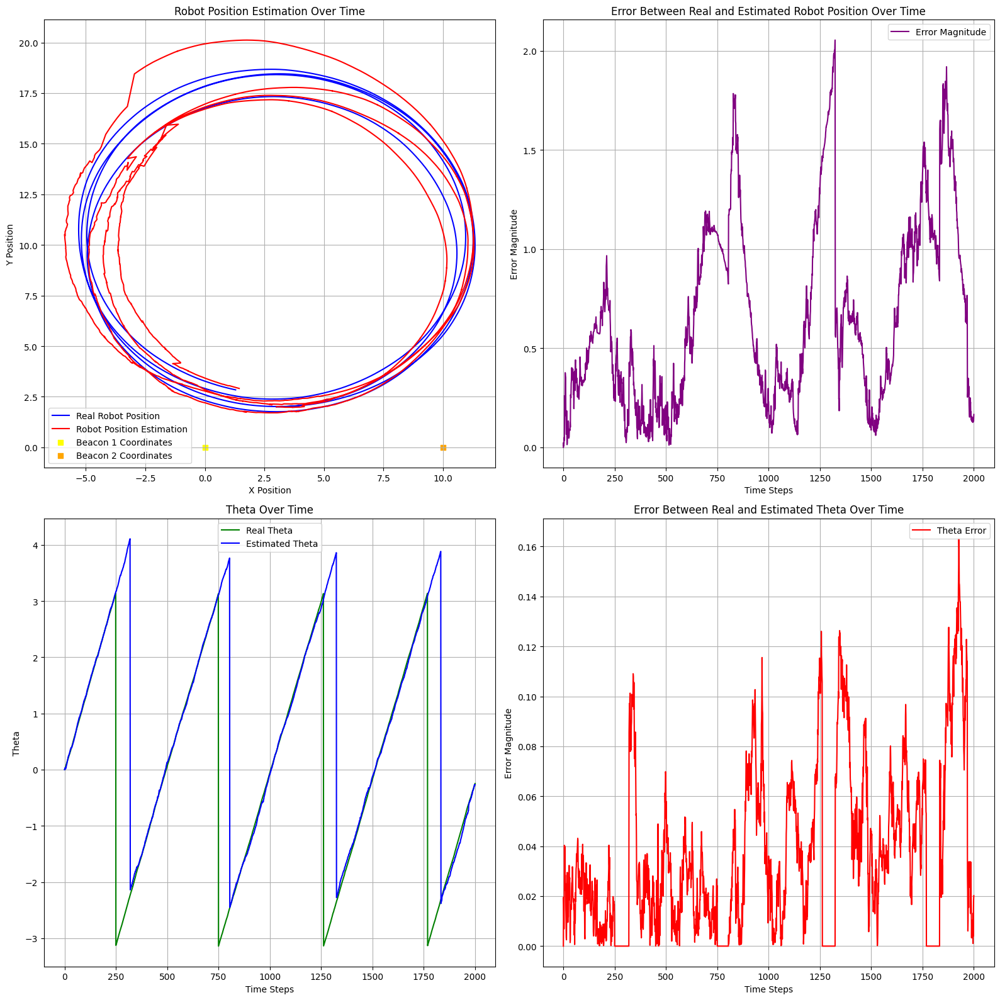

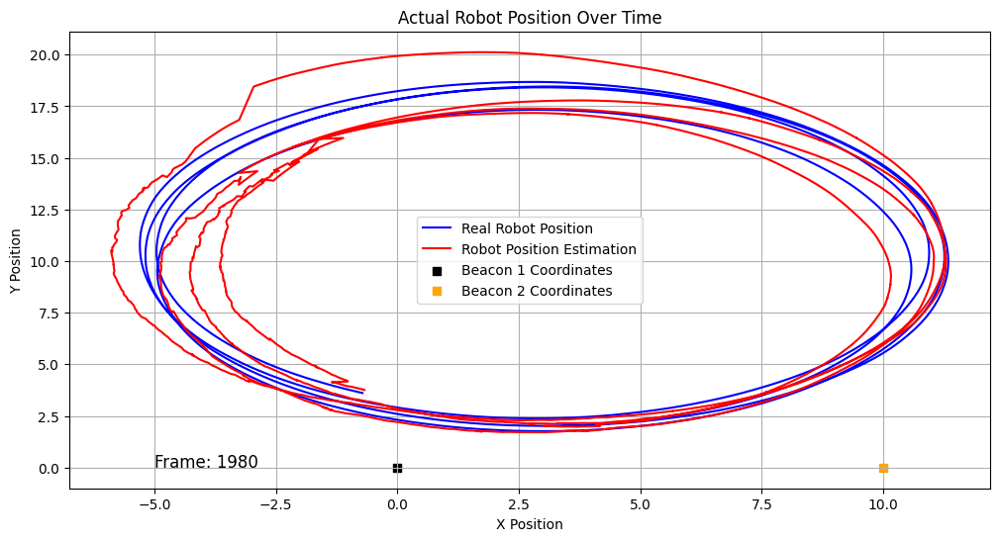

In [ ]:
import numpy as np
from numpy import *
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

def ang_normalized(ang):

    ang_normalized = ang

    while ang_normalized > np.pi:
        ang_normalized = ang_normalized - 2*np.pi

    while ang_normalized <= -np.pi:
        ang_normalized = ang_normalized + 2*np.pi

    return ang_normalized

# Iteration number
N = 2000

# Lists for the results
X_t = []
X_e_t = []
Zmed = []
Zest = []
Ks = []

# Initialize an empty list to store the data
data_list = []

# Open the data file for reading
with open('/content/Datasets-20231026/data3.txt', 'r') as file:
    for line in file:
        # Split the line into individual values using spaces as the delimiter
        values = line.split()

        # Convert the values to the appropriate data types (float in this case)
        t = float(values[0])
        x = float(values[1])
        y = float(values[2])
        theta = float(values[3])
        v = float(values[4])
        omega = float(values[5])
        r = float(values[6])
        psi = float(values[7])

        # Create a dictionary for the current line and append it to the data list
        row_data = {
            't': t,
            'x': x,
            'y': y,
            'theta': theta,
            'v': v,
            'omega': omega,
            'r': r,
            'psi': psi
            }
        data_list.append(row_data)

# Get the data in the respective lists
time = [row['t'] for row in data_list]
x = [row['x'] for row in data_list]
y = [row['y'] for row in data_list]
theta = [row['theta'] for row in data_list]
v = [row['v'] for row in data_list]
w = [row['omega'] for row in data_list]
r = [row['r'] for row in data_list]
psi = [row['psi'] for row in data_list]



# Covariances
P = np.eye(3)*1e-2
Q = np.array([[0.5**2, 0],
     [0, 0.05**2 ]])

# Std for the beacons
sdv_r = 0.5
sdv_psi = 0.1

# Variables to record simulation
X_t = []
X_e_t = []
Zmed = []
Zest = []
Ks = []
B = []

# Beacons coordinates
xp1 = 0
yp1 = 0
xp2 = 10
yp2 = 0

# initial value for the estimated state
X_e = [[x[0]], [y[0]], [theta[0]]]
X = [[x[0]], [y[0]], [theta[0]]]
X_t.append(X)
X_e_t.append(X_e)
xr_e = x[0]
yr_e = y[0]
theta_r_e = theta[0]



# Sampling period
dt = 0.1

for i in range(int(N)):

    # Real Trajectory
    X = [[x[i]], [y[i]], [theta[i]]]

    xr_e = X_e_t[i][0][0]
    yr_e = X_e_t[i][1][0]
    theta_r_e = X_e_t[i][2][0]

    # Predict X(k+1) = f(X(k),U)
    xk= xr_e + v[i]/w[i] * (np.sin(theta_r_e + w[i]*dt) - np.sin(theta_r_e))
    yk = yr_e + v[i]/w[i] * (np.cos(theta_r_e) - np.cos(theta_r_e + w[i]*dt))
    thetak = theta_r_e + w[i] * dt
    X_e = np.array([[xk], [yk], [thetak]])

    # Gradient of f(X)
    grad_f_X = np.array([[1, 0, v[i]/w[i] * (np.cos(theta_r_e + w[i]*dt) - np.cos(theta_r_e))],
            [0, 1, v[i]/w[i] * (np.sin(theta_r_e + w[i]*dt) - np.sin(theta_r_e))],
            [0, 0, 1]])

    # Gradient of f(U)
    grad_f_U = np.array([[1/w[i] * (np.sin(theta_r_e + w[i]*dt) - np.sin(theta_r_e)), v[i]/(w[i]**2) * (dt*w[i]*np.cos(theta_r_e + w[i]*dt) - np.sin(theta_r_e + w[i]*dt)+ np.sin(theta_r_e))],
            [1/w[i] * (-np.cos(theta_r_e + w[i]*dt) + np.cos(theta_r_e)), v[i]/(w[i]**2) * (dt*w[i]*np.sin(theta_r_e + w[i]*dt) + np.cos(theta_r_e + w[i]*dt) - np.cos(theta_r_e))],
            [0, dt]])

    # Covariance propagation
    P = grad_f_X @ P @ grad_f_X.transpose() + grad_f_U @ Q @ grad_f_U.transpose()

    landmark_loc = np.array([[X_e[0][0] + r[i] * np.cos(psi[i] + X_e[2][0])],
                                 [X_e[1][0] + r[i] * np.sin(psi[i] + X_e[2][0])]])


    if(r[i] == 0):
        beacon1 = False
        beacon2 = False
        B.append(0)

    elif (abs(0 - landmark_loc[0][0]) < abs(10 - landmark_loc[0][0])):
        beacon1 = True
        beacon2 = False
        B.append(1)
    else:
        beacon2 = True
        beacon1 = False
        B.append(2)

    # Check if B1 is in the field of view
    if(r[i] != 0 and beacon2):
        # Measures with the actual robot state, z=h(X)
        distp_e_2 = np.sqrt((xp2 - xr_e)**2 + (yp2- yr_e)**2)
        psi_p_e_2 = ang_normalized(np.arctan2(yp2 - yr_e, xp2 - xr_e) - theta_r_e)

        z_e = np.array([[distp_e_2],
            [psi_p_e_2]])

        z = np.array([[r[i]],
                [psi[i]]])

        # Covariance for the measures
        R = [[sdv_r**2, 0],
                [0, sdv_psi**2]]


        # Gradient of h(X)
        grad_h_X  = np.array([[-((xp2 - xr_e)/(np.sqrt((xp2-xr_e)**2+(yp2-yr_e)**2))), -((yp2-yr_e)/(np.sqrt((xp2-xr_e)**2+(yp2-yr_e)**2))), 0],
                [((yp2-yr_e)/((xp2-xr_e)**2+(yp2-yr_e)**2)), -((xp2-xr_e)/((xp2-xr_e)**2+(yp2-yr_e)**2)), -1]])

        # Kalman Gain
        k = P @ grad_h_X.transpose() @ np.linalg.inv(grad_h_X @ P @ grad_h_X.transpose() + R)

        # Covariance update
        P = (np.eye(3)- k @ grad_h_X) @ P

        # State update
        z_dif = z - z_e
        z_dif[1] = ang_normalized(z_dif[1])
        X_e = X_e + k @ (z_dif)
        X_e[2] = ang_normalized(X_e[2])

    # Check if B2 is in the field of view
    elif(r[i] != 0 and beacon1):
        # Measures with the actual robot state, z=h(X)
        distp_e_1 = np.sqrt((xp1 - xr_e)**2 + (yp1 - yr_e)**2)
        psi_p_e_1 = ang_normalized(np.arctan2(yp1 - yr_e, xp1 - xr_e) - theta_r_e)

        z_e = np.array([[distp_e_1],
                [psi_p_e_1]])

        z = np.array([[r[i]],
                [psi[i]]])

        # Covariance for the measures
        R = [[sdv_r**2, 0],
                [0, sdv_psi**2]]


        # Gradient of h(X)
        grad_h_X  = np.array([[-((xp1 - xr_e)/(np.sqrt((xp1-xr_e)**2+(yp1-yr_e)**2))), -((yp1-yr_e)/(np.sqrt((xp1-xr_e)**2+(yp1-yr_e)**2))), 0],
                [((yp1-yr_e)/((xp1-xr_e)**2+(yp1-yr_e)**2)), -((xp1-xr_e)/((xp1-xr_e)**2+(yp1-yr_e)**2)), -1]])

        # Kalman Gain
        k = P @ grad_h_X.transpose() @ np.linalg.inv(grad_h_X @ P @ grad_h_X.transpose() + R)

        # State update
        z_dif = z - z_e
        z_dif[1] = ang_normalized(z_dif[1])
        X_e = X_e + k @ (z_dif)
        X_e[2] = ang_normalized(X_e[2])

        P = P - k @ (grad_h_X @ P @ grad_h_X.T + R) @ k.T


    # Save the results in lists
    X_t.append(X)
    X_e_t.append(X_e)


# Initialize empty lists for x and y values
x_real = []
y_real = []
x_est = []
y_est = []
theta_est = []
theta_real = []

# Extract x and y values from each array in the list
for array in X_t:
    x_real.append(array[0])  # Extract x (first element)
    y_real.append(array[1])  # Extract y (second element)
    theta_real.append(array[2]) # Extract theta (third element)

# Extract x and y values from each array in the list
for array in X_e_t:
    x_est.append(array[0])  # Extract x (first element)
    y_est.append(array[1])  # Extract y (second element)
    theta_est.append(array[2]) # Extract theta (third element)

# Create a figure with a 4x4 subplot layout
fig, axs = plt.subplots(2, 2, figsize=(16, 16))

# Plot for 'x' vs. 'y'
axs[0, 0].plot(x_real, y_real, label='Real Robot Position', color='b')
axs[0, 0].plot(x_est, y_est, label='Robot Position Estimation', color='r')
axs[0, 0].scatter(xp1, yp1, label='Beacon 1 Coordinates', color='yellow', marker='s')
axs[0, 0].scatter(xp2, yp2, label='Beacon 2 Coordinates', color='orange', marker='s')
axs[0, 0].set_xlabel('X Position')
axs[0, 0].set_ylabel('Y Position')
axs[0, 0].set_title('Robot Position Estimation Over Time')
axs[0, 0].legend()
axs[0, 0].grid(True)

# Calculate error using square root of sum of squared distances
error = np.sqrt((np.array(x_real) - np.array(x_est))**2 + (np.array(y_real) - np.array(y_est))**2)

# Plot for the error
axs[0, 1].plot(error, label='Error Magnitude', color='purple')
axs[0, 1].set_xlabel('Time Steps')
axs[0, 1].set_ylabel('Error Magnitude')
axs[0, 1].set_title('Error Between Real and Estimated Robot Position Over Time')
axs[0, 1].legend()
axs[0, 1].grid(True)

# Plot for 'theta_real' and 'theta_est'
axs[1, 0].plot(theta_real, label='Real Theta', color='green')
axs[1, 0].plot(theta_est, label='Estimated Theta', color='blue')
axs[1, 0].set_xlabel('Time Steps')
axs[1, 0].set_ylabel('Theta')
axs[1, 0].set_title('Theta Over Time')
axs[1, 0].legend()
axs[1, 0].grid(True)

# Calculate error for theta
theta_error = np.abs(np.array(theta_real) - np.array(theta_est))

# Set values greater than 1 to 0
theta_error[theta_error > 1] = 0

# Plot for the theta error
axs[1, 1].plot(theta_error, label='Theta Error', color='red')
axs[1, 1].set_xlabel('Time Steps')
axs[1, 1].set_ylabel('Error Magnitude')
axs[1, 1].set_title('Error Between Real and Estimated Theta Over Time')
axs[1, 1].legend()
axs[1, 1].grid(True)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plots
plt.show()
# Create a function to update the plot in each animation frame
def update(frame):
    frame = frame * 20
    plt.clf()  # Clear the previous frame
    plt.plot(x_real[:frame], y_real[:frame], label='Real Robot Position', color='b')
    plt.plot(x_est[:frame], y_est[:frame], label='Robot Position Estimation', color='r')

    detected_1 = 'yellow' if B[frame] == 1 else 'k'
    detected_2 = 'orange' if B[frame] == 2 else 'k'

    plt.scatter(xp1, yp1, label='Beacon 1 Coordinates', color=detected_1, marker='s')
    plt.scatter(xp2, yp2, label='Beacon 2 Coordinates', color=detected_2, marker='s')

    plt.xlabel('X Position')
    plt.ylabel('Y Position')
    plt.title('Actual Robot Position Over Time')
    plt.text(-5, 0, f'Frame: {frame}', fontsize=12, color='black')  # Add frame number as text
    plt.legend()
    plt.grid(True)


if(ani_enable3 == 1):
  # Create a figure
  plt.figure(figsize=(12, 6))

  ani = FuncAnimation(plt.gcf(), update, frames=100, repeat=False)
  display(HTML(ani.to_jshtml()))

  # Show the plots
  plt.show()






### Considerations for Task 3

In this third scenario, the measurements were coming from the closest landmark, thus it was necessary to define criteria to determine from which landmark we were receiving the data. Ultimately, this criteria was around two factors:

* The position of the robot
* The orientation of the robot

Given that the position of the beacons was known, it was possible to estimate from what beacon the measurement was sent. Using the distance and bearing received, taking into account the estimated position of the robot:

<br>

 \begin{equation} x_{beacon} = x_r + Distance \cdot cos(Bearing + θ_r)
\end{equation}

<br>

By estimating the x value of the landmark, it was possible to then compare it to the real value of the abscissa of the known beacons, as such:

If,

 \begin{equation} abs(x_{beacon1, real} - x_{estimated}) < abs(x_{beacon2, real} - x_{estimated})
\end{equation}

<br>

Therefore it could be concluded that the measurements being received were, most likely, sent by Beacon 1, or the other way around.

In the result graphs, it is possible to observe that the error regarding the position of the robot and its orientation increases exceedingly in regions where the robot is not receiving any measurements, due to the angle measurement constraints, explained in Task 2.

##Task 4

Consider now that there are several beacons in the operation are, that the laser system still has the above
field of view constraint and that it only returns the information to the closest landmark. Also assume
that you have no prior information about the initial robot pose.
Design and implement an algorithm (based on the SLAM concept) to estimate the position of the robot
and the lcoations of the landmarks in the operation area.
Now assume that besides the field of view constraint the laser system only returns the range/bearing to
the closest landmark, not proving information to which lankmark the measrument refers . Update to
algorithm to deal with such feature. Use the data in file data4.txt to test the algorithm. The columns
of this file are t, x, y, θ, v, ω, r, ψ.

In [ ]:
ani_enable4 = 0

In [ ]:
import numpy as np
from numpy import *
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


def ang_normalized(ang):

    ang_normalized = ang

    while ang_normalized > np.pi:
        ang_normalized = ang_normalized - 2*np.pi

    while ang_normalized <= -np.pi:
        ang_normalized = ang_normalized + 2*np.pi

    return ang_normalized

# Iteration number
N = 2000


# Lists for the results
X_t = []
X_e_t = []

# Initialize an empty list to store the data
data_list = []

# Open the data file for reading
with open('/content/Datasets-20231026/data4.txt', 'r') as file:
    for line in file:
        # Split the line into individual values using spaces as the delimiter
        values = line.split()

        # Convert the values to the appropriate data types (float in this case)
        t = float(values[0])
        x = float(values[1])
        y = float(values[2])
        theta = float(values[3])
        v = float(values[4])
        omega = float(values[5])
        r = float(values[6])
        psi = float(values[7])


        # Create a dictionary for the current line and append it to the data list
        row_data = {
            't': t,
            'x': x,
            'y': y,
            'theta': theta,
            'v': v,
            'omega': omega,
            'r': r,
            'psi': psi
        }
        data_list.append(row_data)

# Get the data in the respective lists
time = [row['t'] for row in data_list]
x = [row['x'] for row in data_list]
y = [row['y'] for row in data_list]
theta = [row['theta'] for row in data_list]
v = [row['v'] for row in data_list]
w = [row['omega'] for row in data_list]
r = [row['r'] for row in data_list]
psi = [row['psi'] for row in data_list]


# Covariances
Q = np.array([[0.5**2, 0],
     [0, 0.05**2]])

# Std for the beacons
sdv_r = 0.5
sdv_psi = 0.1

# Variables to record simulation
X_t = []
X_e_t = []
landNum = 0
landNumlist = []

# initial value for the estimated state
X_e = [[3], [2], [0]]
X_e_t.append(X_e)
X = [[x[0]], [y[0]], [theta[0]]]
X_t.append(X)


# Create list for landmarks
landmarks = []
nr_landmarks = 0
state_dim = 3 + 2 * nr_landmarks
P = np.eye(state_dim)*1e-3

# Sampling period
dt = 0.1

for i in range(N-1):

    # Real Trajectory
    X = [[x[i]], [y[i]], [theta[i]]]

    # Predict X(k+1) = f(X(k),U)
    xr_e = X_e_t[i][0][0]
    yr_e = X_e_t[i][1][0]
    theta_r_e = X_e_t[i][2][0]

    mat = np.eye(3)
    zero_columns = np.zeros((mat.shape[0], nr_landmarks*2))
    FxT = np.hstack((mat, zero_columns))


    Mot = np.array([[v[i]/w[i] * (np.sin(theta_r_e + w[i]*dt) - np.sin(theta_r_e))],
            [v[i]/w[i] * (np.cos(theta_r_e) - np.cos(theta_r_e + w[i]*dt))],
            [w[i] * dt]])

    X_e = X_e + FxT.T @ Mot


    # Gradient of f(X)
    grad_f_X = np.array([[1, 0, v[i]/w[i] * (np.cos(theta_r_e + w[i]*dt) - np.cos(theta_r_e))],
            [0, 1, v[i]/w[i] * (np.sin(theta_r_e + w[i]*dt) - np.sin(theta_r_e))],
            [0, 0, 1]])

    if(state_dim == 3):
        Gt = grad_f_X
    else:
        expanded = np.eye((state_dim))
        expanded[0:3, 0:3] = grad_f_X
        Gt = expanded

    # Gradient of f(U)
    grad_f_U = np.array([[1/w[i] * (np.sin(theta_r_e + w[i]*dt) - np.sin(theta_r_e)), v[i]/(w[i]**2) * (dt*w[i]*np.cos(theta_r_e + w[i]*dt) - np.sin(theta_r_e + w[i]*dt)+ np.sin(theta_r_e))],
            [1/w[i] * (-np.cos(theta_r_e + w[i]*dt) + np.cos(theta_r_e)), v[i]/(w[i]**2) * (dt*w[i]*np.sin(theta_r_e + w[i]*dt) + np.cos(theta_r_e + w[i]*dt) - np.cos(theta_r_e))],
            [0, dt]])

    if(nr_landmarks == 0):
        Ut = grad_f_U
    else:
        zero_rows = np.zeros((nr_landmarks*2, 2))
        Ut = np.vstack((grad_f_U, zero_rows))

    # Covariance propagation
    P = Gt @ P @ Gt.T + Ut @ Q @ Ut.T

    landNum = -1
    if(r[i] != 0.0):

        landmark_loc = np.array([[X_e[0][0] + r[i] * np.cos(psi[i] + X_e[2][0])],
                                 [X_e[1][0] + r[i] * np.sin(psi[i] + X_e[2][0])]])

        landmark_features = np.array([[r[i]],
                                 [psi[i]]])

        # First landmark
        if(nr_landmarks == 0):

            landmarks.append(landmark_loc)
            nr_landmarks += 1
            state_dim = 3 + 2 * nr_landmarks

            X_e = np.vstack((X_e, landmark_features))
            expanded = np.eye(state_dim) * 10e99
            expanded[0:state_dim-2, :state_dim-2] = P
            P = expanded

            distp_e = np.sqrt((landmark_loc[0][0] - X_e[0][0])**2 + (landmark_loc[1][0] - X_e[1][0])**2)
            psi_p_e = ang_normalized(np.arctan2(landmark_loc[1][0] - X_e[1][0], landmark_loc[0][0] - X_e[0][0]) - X_e[2][0])

            z_e = np.array([[distp_e],
                    [psi_p_e]])

            z = np.array([[r[i]],
                    [psi[i]]])

            # Covariance for the measures
            R = [[sdv_r**2, 0],
                    [0, sdv_psi**2]]

            # Gradient of h(X)
            grad_h_X  = np.array([[-((landmark_loc[0][0] - X_e[0][0])/(np.sqrt((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2))), -((landmark_loc[1][0]-X_e[1][0])/(np.sqrt((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2))), 0, ((landmark_loc[0][0] - X_e[0][0])/(np.sqrt((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2))), ((landmark_loc[1][0]-X_e[1][0])/(np.sqrt((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2)))],
                    [((landmark_loc[1][0]-X_e[1][0])/((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2)), -((landmark_loc[0][0]-X_e[0][0])/((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2)), -1, -((landmark_loc[1][0]-X_e[1][0])/((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2)), ((landmark_loc[0][0]-X_e[0][0])/((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2))]])

            FxJ = grad_h_X

            # Kalman Gain
            k = P @ FxJ.T @ np.linalg.inv(FxJ @ P @ FxJ.T + R)

            # Covariance update
            P = (np.eye(state_dim) - k @ FxJ) @ P

            # State update
            z_dif = z - z_e
            z_dif[1] = ang_normalized(z_dif[1])
            X_e = X_e + k @ (z_dif)
            X_e[2] = ang_normalized(X_e[2])

            landNum = 0

        else:
            # If there are known beacons, associate the measurement with the closest one
            min_distance = float("inf")
            closest_landmark_idx = -1

            for j, landmark in enumerate(landmarks):
                distance = np.sqrt((landmark_loc[0][0] - landmark[0]) ** 2 + (landmark_loc[1][0] - landmark[1]) ** 2)
                if distance < min_distance:
                    min_distance = distance
                    closest_landmark_idx = j

            # Check if the measurement corresponds to a known landmark or a new one
            if min_distance < 10:
                # If associated with a known beacon, update that landmark
                closest_landmark = landmarks[closest_landmark_idx]

                # Update the associated landmark logic here
                distp_e = np.sqrt((closest_landmark[0][0] - X_e[0][0])**2 + (closest_landmark[1][0] - X_e[1][0])**2)
                psi_p_e = ang_normalized(np.arctan2(closest_landmark[1][0] - X_e[1][0], closest_landmark[0][0] - X_e[0][0]) - X_e[2][0])

                z_e = np.array([[distp_e],
                        [psi_p_e]])

                z = np.array([[r[i]],
                        [psi[i]]])

                # Covariance for the measures
                R = [[sdv_r**2, 0],
                        [0, sdv_psi**2]]


                # Gradient of h(X)
                grad_h_X  = np.array([[-((closest_landmark[0][0] - X_e[0][0])/(np.sqrt((closest_landmark[0][0]-X_e[0][0])**2+(closest_landmark[1][0]-X_e[1][0])**2))), -((closest_landmark[1][0]-X_e[1][0])/(np.sqrt((closest_landmark[0][0]-X_e[0][0])**2+(closest_landmark[1][0]-X_e[1][0])**2))), 0, ((closest_landmark[0][0] - X_e[0][0])/(np.sqrt((closest_landmark[0][0]-X_e[0][0])**2+(closest_landmark[1][0]-X_e[1][0])**2))), ((closest_landmark[1][0]-X_e[1][0])/(np.sqrt((closest_landmark[0][0]-X_e[0][0])**2+(closest_landmark[1][0]-X_e[1][0])**2)))],
                        [((closest_landmark[1][0]-X_e[1][0])/((closest_landmark[0][0]-X_e[0][0])**2+(closest_landmark[1][0]-X_e[1][0])**2)), -((closest_landmark[0][0]-X_e[0][0])/((closest_landmark[0][0]-X_e[0][0])**2+(closest_landmark[1][0]-X_e[1][0])**2)), -1, -((closest_landmark[1][0]-X_e[1][0])/((closest_landmark[0][0]-X_e[0][0])**2+(closest_landmark[1][0]-X_e[1][0])**2)), ((closest_landmark[0][0]-X_e[0][0])/((closest_landmark[0][0]-X_e[0][0])**2+(closest_landmark[1][0]-X_e[1][0])**2))]])

                if(nr_landmarks == 1):
                    FxJ = grad_h_X
                else:
                    iden = np.eye(5)
                    zero_mat_before = np.zeros((5, 2*j-2))
                    zero_mat_after = np.zeros((5, 2*nr_landmarks-2*j))
                    FxJ = np.insert(iden, [3], zero_mat_before, axis = 1)
                    FxJ = np.insert(FxJ, [5 + (2*j-2)], zero_mat_after, axis = 1)
                    FxJ = grad_h_X @ FxJ

                # Kalman Gain
                k = P @ FxJ.T @ np.linalg.inv(FxJ @ P @ FxJ.T + R)

                # Covariance update
                P = (np.eye(state_dim) - k @ FxJ) @ P

                # State update
                z_dif = z - z_e
                z_dif[1] = ang_normalized(z_dif[1])
                X_e = X_e + k @ (z_dif)
                X_e[2] = ang_normalized(X_e[2])

                landNum = closest_landmark_idx

            else:
                j+=1
                # If not associated with any known beacon, add as a new landmark
                landmarks.append(landmark_loc)
                nr_landmarks += 1
                state_dim = 3 + 2 * nr_landmarks

                # Expand state and covariance matrices
                X_e = np.vstack((X_e, landmark_features))
                expanded = np.eye(state_dim) * 10  # Adjust covariance initialization as needed
                expanded[0:state_dim - 2, 0:state_dim - 2] = P
                P = expanded

                distp_e = np.sqrt((landmark_loc[0][0] - X_e[0][0])**2 + (landmark_loc[1][0] - X_e[1][0])**2)
                psi_p_e = ang_normalized(np.arctan2(landmark_loc[1][0] - X_e[1][0], landmark_loc[0][0] - X_e[0][0]) - X_e[2][0])

                z_e = np.array([[distp_e],
                        [psi_p_e]])

                z = np.array([[r[i]],
                        [psi[i]]])

                # Covariance for the measures
                R = [[sdv_r**2, 0],
                        [0, sdv_psi**2]]

                # Gradient of h(X)
                grad_h_X  = np.array([[-((landmark_loc[0][0] - X_e[0][0])/(np.sqrt((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2))), -((landmark_loc[1][0]-X_e[1][0])/(np.sqrt((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2))), 0, ((landmark_loc[0][0] - X_e[0][0])/(np.sqrt((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2))), ((landmark_loc[1][0]-X_e[1][0])/(np.sqrt((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2)))],
                        [((landmark_loc[1][0]-X_e[1][0])/((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2)), -((landmark_loc[0][0]-X_e[0][0])/((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2)), -1, -((landmark_loc[1][0]-X_e[1][0])/((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2)), ((landmark_loc[0][0]-X_e[0][0])/((landmark_loc[0][0]-X_e[0][0])**2+(landmark_loc[1][0]-X_e[1][0])**2))]])

                if(nr_landmarks == 1):
                    FxJ = grad_h_X
                else:
                    iden = np.eye(5)
                    zero_mat_before = np.zeros((5, 2*j-2))
                    zero_mat_after = np.zeros((5, 2*nr_landmarks-2*j))
                    FxJ = np.insert(iden, [3], zero_mat_before, axis = 1)
                    FxJ = np.insert(FxJ, [5 + (2*j-2)], zero_mat_after, axis = 1)
                    FxJ = grad_h_X @ FxJ

                # Kalman Gain
                k = P @ FxJ.T @ np.linalg.inv(FxJ @ P @ FxJ.T + R)


                # Covariance update
                P = (np.eye(state_dim) - k @ FxJ) @ P

                # State update
                z_dif = z - z_e
                z_dif[1] = ang_normalized(z_dif[1])
                X_e = X_e + k @ (z_dif)
                X_e[2] = ang_normalized(X_e[2])

                landNum = nr_landmarks-1


    # Save the results in lists
    X_t.append(X)
    X_e_t.append(X_e)
    landNumlist.append(landNum)


# Initialize empty lists for x and y values
x_real = []
y_real = []
x_est = []
y_est = []
x_beacons = []
y_beacons = []
theta_est = []
theta_real = []

# Extract x and y values from each array in the list
for array in X_t:
    x_real.append(array[0])  # Extract x (first element)
    y_real.append(array[1])  # Extract y (second element)
    theta_real.append(array[2]) # Extract theta (third element)

# Extract x and y values from each array in the list
for array in X_e_t:
    x_est.append(array[0])  # Extract x (first element)
    y_est.append(array[1])  # Extract y (second element)
    theta_est.append(array[2]) # Extract theta (third element)

# Extract x and y values from each array in the list
for array in landmarks:
    x_beacons.append(array[0])  # Extract x (first element)
    y_beacons.append(array[1])  # Extract y (second element)

# Create a figure with a 4x4 subplot layout
fig, axs = plt.subplots(2, 2, figsize=(16, 16))

# Plot for 'x' vs. 'y'
axs[0, 0].plot(x_real, y_real, label='Real Robot Position', color='b')
axs[0, 0].plot(x_est, y_est, label='Robot Position Estimation', color='r')
axs[0, 0].scatter(x_beacons, y_beacons, label='Possible Beacon Coordinates', color='orange', marker='s')
axs[0, 0].set_xlabel('X Position')
axs[0, 0].set_ylabel('Y Position')
axs[0, 0].set_title('Robot Position Estimation Over Time')
axs[0, 0].legend()
axs[0, 0].grid(True)

# Calculate error using square root of sum of squared distances
error = np.sqrt((np.array(x_real) - np.array(x_est))**2 + (np.array(y_real) - np.array(y_est))**2)

# Plot for the error
axs[0, 1].plot(error, label='Error Magnitude', color='purple')
axs[0, 1].set_xlabel('Time Steps')
axs[0, 1].set_ylabel('Error Magnitude')
axs[0, 1].set_title('Error Between Real and Estimated Robot Position Over Time')
axs[0, 1].legend()
axs[0, 1].grid(True)

# Plot for 'theta_real' and 'theta_est'
axs[1, 0].plot(theta_real, label='Real Theta', color='green')
axs[1, 0].plot(theta_est, label='Estimated Theta', color='blue')
axs[1, 0].set_xlabel('Time Steps')
axs[1, 0].set_ylabel('Theta')
axs[1, 0].set_title('Theta Over Time')
axs[1, 0].legend()
axs[1, 0].grid(True)

# Calculate error for theta
theta_error = np.abs(np.array(theta_real) - np.array(theta_est))

# Set values greater than 1 to 0
theta_error[theta_error > 1] = 0

# Plot for the theta error
axs[1, 1].plot(theta_error, label='Theta Error', color='red')
axs[1, 1].set_xlabel('Time Steps')
axs[1, 1].set_ylabel('Error Magnitude')
axs[1, 1].set_title('Error Between Real and Estimated Theta Over Time')
axs[1, 1].legend()
axs[1, 1].grid(True)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plots
plt.show()

#Create a function to update the plot in each animation frame
def update(frame):
    frame = frame * 20
    plt.clf()  # Clear the previous frame
    plt.plot(x_real[:frame], y_real[:frame], label='Real Robot Position')
    plt.plot(x_est[:frame], y_est[:frame], label='Robot Position Estimation')
    detected_0 = 'orange' if landNumlist[frame] == 0 else 'k'
    detected_1 = 'orange' if landNumlist[frame] == 1 else 'k'
    detected_2 = 'orange' if landNumlist[frame] == 2 else 'k'
    detected_3 = 'orange' if landNumlist[frame] == 3 else 'k'

    plt.scatter(x_beacons[0], y_beacons[0], label='Beacon 0 Coordinates', color=detected_0, marker='s')
    plt.scatter(x_beacons[1], y_beacons[1], label='Beacon 1 Coordinates', color=detected_1, marker='s')
    plt.scatter(x_beacons[2], y_beacons[2], label='Beacon 2 Coordinates', color=detected_2, marker='s')
    plt.scatter(x_beacons[3], y_beacons[3], label='Beacon 3 Coordinates', color=detected_3, marker='s')
    plt.xlabel('X Position')
    plt.ylabel('Y Position')
    plt.title('Actual Robot Position Over Time')
    plt.legend()
    plt.grid(True)
    plt.text(-5, 0, f'Frame: {frame}', fontsize=12, color='black')  # Add frame number as text


if(ani_enable4 == 1):
  # Create a figure
  plt.figure(figsize=(12, 6))

  ani = FuncAnimation(plt.gcf(), update, frames=100, repeat=False)
  display(HTML(ani.to_jshtml()))

  # Show the plots
  plt.show()




### Considerations for Taks 4

In the final task, besides the restrictions depicted in Tasks 3 and 4, there is also an uncertainty related to the landmark positions. This constitutes a SLAM - Simultaneous Localization and Mapping matter.

Alongside the SLAM we used EKF to estimate the robot and landmarks positions.

In SLAM, some changes need to be considered in the algorithm to make it dynamic:

* The state estimate has 3 uncertainties related to the robot (x, y, and theta) and 2 uncertainties for each landmark detected (r and psi). The state has now dimensions of ($3 + 2*N$ x $1$), where N is the number of landmarks.

<br>
\begin{equation}
X_e =
\begin{bmatrix}
  x_{k}\\
  y_{k}\\
  \theta_{k}\\
  r_{k+1}\\
  \psi_{k+1}\\
  \vdots
\end{bmatrix}
\end{equation}
<br>

* The motion equation, $M$, now has to be dynamic too, which means the first three rows stay the same, but the other $2*N$ need to be filled with zeros.

<br>
\begin{equation}
M =
\begin{bmatrix}
 \frac{v_k}{w_k} \cdot [sin(θ_{k+1}) - sin(θ_k)]\\
  \frac{v_k}{w_k} \cdot [cos(θ_k)-cos(θ_{k+1}) ]\\
  w_k \cdot Δt\\
  0\\
  0\\
  \vdots
\end{bmatrix}
\end{equation}
<br>

* Thus the final equation is:

<br>
\begin{equation}
X_{k+1} = X{e} + M
\end{equation}
<br>

* The Jacobian of the Motion, $J_X$ needs to be increased by adding two 1s in the diagonal for each landmark added.
<br>
\begin{equation}
J_X =
\begin{bmatrix}
 \frac{\partial x_{k+1}}{\partial x} & \frac{\partial X_{k+1}}{\partial y} &
 \frac{\partial x_{k+1}}{\partial \theta} &
 \frac{\partial x_{k+1}}{\partial r} &
 \frac{\partial x_{k+1}}{\partial \psi}\\
 \frac{\partial y_{k+1}}{\partial x} &
 \frac{\partial y_{k+1}}{\partial y} &
 \frac{\partial y_{k+1}}{\partial \theta} &
 \frac{\partial y_{k+1}}{\partial r} &
 \frac{\partial y_{k+1}}{\partial \psi}\\
 \frac{\partial \theta_{k+1}}{\partial x} &
 \frac{\partial \theta_{k+1}}{\partial y} &
 \frac{\partial \theta_{k+1}}{\partial \theta} &
 \frac{\partial \theta_{k+1}}{\partial r} &
 \frac{\partial \theta_{k+1}}{\partial \psi} &
 \dots\\
 \frac{\partial r_{k+1}}{\partial x} &
 \frac{\partial r_{k+1}}{\partial y} &
 \frac{\partial r_{k+1}}{\partial \theta} &
 \frac{\partial r_{k+1}}{\partial r} &
 \frac{\partial r_{k+1}}{\partial \psi}\\
 \frac{\partial \psi_{k+1}}{\partial x} &
 \frac{\partial \psi_{k+1}}{\partial y} &
 \frac{\partial \psi_{k+1}}{\partial \theta} &
 \frac{\partial \psi_{k+1}}{\partial r} &
 \frac{\partial \psi_{k+1}}{\partial \psi}\\
  &  & \vdots & &  &
\end{bmatrix}
\end{equation}
<br>

* The Jacobian of the inputs, $J_U$, was also adjusted to be increased by adding two rows of zeros for each landmark:

<br>
\begin{equation}
J_U =
\begin{bmatrix}
 \frac{\partial x_{k+1}}{\partial v} &
 \frac{\partial x_{k+1}}{\partial w} \\
 \frac{\partial y_{k+1}}{\partial v} &
 \frac{\partial y_{k+1}}{\partial w} \\
 \frac{\partial \theta_{k+1}}{\partial v} &
 \frac{\partial \theta_{k+1}}{\partial w}\\
 \frac{\partial r_{k+1}}{\partial v} &
 \frac{\partial r_{k+1}}{\partial w}\\
 \frac{\partial \psi_{k+1}}{\partial c} &
 \frac{\partial \psi_{k+1}}{\partial 2}\\
 \vdots & \vdots
\end{bmatrix}
\end{equation}
<br>

* The P covariance matrix is also dynamically increased for each new landmark discovered. For that matter, it was input the value $10e99$ of uncertainty upon initialization of a new feature. This value was added in the diagonal of the P which has a dimension of ($3+2*N$ x $3+2*N$).

<br>

Regarding the landmarks, it was necessary to have a criterion relative to the decision to add new landmarks that were detected and whether or not they were known landmarks.

To restrain the number of landmarks detected, after the first measurement of a landmark in a "new" area, a threshold would be applied. That is no new landmark should be added in case the distance to the original landmark is higher than a certain threshold.

<br>

\begin{equation} \sqrt{(x_{beacon} - x_{newbeacon})^2 + (y_{beacon} - x_{newbeacon})^2} < 10
\end{equation}

To ease the results regarding the graphs displayed and animation, we set the starting position of the estimation as the real starting position. Starting in a different position would shift the map towards that direction.

In total, 4 landmarks were discovered, represented in the graphs and animations, with the following coordinates:
* $L1 = (11.57 , 1.17)$
* $L2 = (14.22 , 20.58)$
* $L3 = (-3.67 , 22.34)$
* $L4 = (-1.31 , 0.56)$

<br>
In conclusion, the error regarding the estimate position did not converge, partially because there seems to be an error regarding the fourth beacon that the robot encounters, not being able to reduce the covariance once it encounters this beacon. That is why it is possible to see in the position graph below that after the third beacon the error regarding the position is increasing, meaning that the covariance is not decreasing as it should.
On the bright side, the algorithm seems to reduce the covariance drastically once it finds the first beacon, meaning that it was able to close the loop as intended in SLAM.